In [100]:
%matplotlib inline
%load_ext memory_profiler

import os
import sys 
import pickle
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import time
import warnings
import glob

from scipy.stats import zscore, binned_statistic
from scipy import sparse

import magic 
import graphtools as gt
import phate
import scanpy as sc
import scvelo as scv


# settings
plt.rc('font', size = 9)
plt.rc('font', family='sans serif')
plt.rcParams['pdf.fonttype']=42
plt.rcParams['ps.fonttype']=42
plt.rcParams['text.usetex']=False
plt.rcParams['legend.frameon']=False
plt.rcParams['axes.grid']=False
plt.rcParams['legend.markerscale']=0.5
sc.set_figure_params(dpi=300,dpi_save=600,
                     frameon=False,
                     fontsize=9)
plt.rcParams['savefig.dpi']=600
sc.settings.verbosity=2
scv.settings.n_jobs=-1
sns.set_style("ticks")


The memory_profiler extension is already loaded. To reload it, use:
  %reload_ext memory_profiler


In [2]:
# fps
pfp = '/home/ngr4/project/scnd/results/'
sc.settings.figdir = pfp
scv.settings.figdir = pfp

In [3]:
# scRNA-seq data
updated200709 = False

if updated200709:
    hdata = sc.read('/home/ngr4/project/scnd/data/processed/hum_ctrl.h5ad')
else:
    hdata = sc.read('/home/ngr4/project/scnd/data/processed/hum_MT_bbknn.h5ad')

In [4]:
# read in looms
## point to directory where ./sample1 ./sample2, etc. exists and ./sample/*loom exists
loom_fpath = '/home/ngr4/project/scnd/data/human/'
loom_files = glob.glob(os.path.join(loom_fpath,'*/*.loom'))
sample_names = [os.path.split(os.path.split(loom_files[i])[0])[1] for i in range(len(loom_files))]

adata_looms = {}
for i in range(len(loom_files)):
    start = time.time()
    if i == 0:
        adata_loom = scv.read_loom(loom_files[i],sparse=True,cleanup=True)
        adata_loom.var_names_make_unique()
    else:
        adata_looms[sample_names[i]] = scv.read_loom(loom_files[i],sparse=True,cleanup=True)
        adata_looms[sample_names[i]].var_names_make_unique()
try:
    adata_loom = adata_loom.concatenate(*adata_looms.values(), batch_categories=sample_names)
except ValueError:
    adata_loom = adata_loom.concatenate(*adata_looms.values(), batch_categories=sample_names)
    
if True:
    # merge with existing adata
    adata = scv.utils.merge(hdata, adata_loom)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [72]:
def do_phateumap(X, bbknn=True):
    if bbknn:
        sc.external.pp.bbknn(X,batch_key='batch', 
                             n_pcs=50, 
                             neighbors_within_batch=int(30/len(X.obs['batch'].unique()))) # neighbors_within_batch=int(30/len(X.obs['batch'].unique()))
    else :
        sc.pp.neighbors(X,n_neighbors=30,n_pcs=100)
    sc.tl.umap(X)
    sc.tl.leiden(X)

    # compute PHATE
    G = gt.Graph(data=X.uns['neighbors']['connectivities']+sparse.diags([1]*X.shape[0],format='csr'),
                 precomputed='adjacency',
                 use_pygsp=True)
    G.knn_max = None

    mess_with_phate_smoothness = False
    if mess_with_phate_smoothness:
        phate_op = phate.PHATE(knn_dist='precomputed',
                               gamma=1,
                               decay=5,
                               t=40,
                               n_jobs=-1)
    else: 
        phate_op = phate.PHATE(knn_dist='precomputed',
                               gamma=0,
                               n_jobs=-1)
    X.obsm['X_phate']=phate_op.fit_transform(G.K)
    return X

def do_magic(X, goi=None):
    # compute PHATE
    G = gt.Graph(data=X.uns['neighbors']['connectivities']+sparse.diags([1]*X.shape[0],format='csr'),
                 precomputed='adjacency',
                 use_pygsp=True)
    G.knn_max = None
    

    # magic params
    t=30
    
    if goi is None:
        magic_op = magic.MAGIC(t=t).fit(X=adata.X, graph=G)
        adata.layers['imputed'] = magic_op.transform(adata.X, genes='all')
        return adata
    else:
        
        magic_op = magic.MAGIC(t=t).fit(X=adata[:, goi].X, graph=G)
        Xprime = magic_op.transform(adata[:, goi].X)
        return pd.DataFrame(Xprime, columns=goi, index=adata.obs.index.to_list())

In [6]:
Xprime = do_magic(adata, goi=['PDGFRA', 'MOG', 'MAG', 'MBP'])

Running MAGIC on 41150 cells and 4 genes.
Using precomputed graph and diffusion operator...
Calculating imputation...
Calculated imputation in 0.20 seconds.


In [7]:
for i in Xprime.columns:
    adata.obs['{} (imputed)'.format(i)] = Xprime[i]

In [10]:
adata.obs.ctype.unique()

['Granule cell', 'GABAergic interneuron 1', 'Pericyte', 'Astrocyte', 'Bergmann glia', 'Oligodendrocyte', 'Microglia', 'GABAergic interneuron 2', 'Oligodendrocyte progenitor cell']
Categories (9, object): ['Granule cell', 'GABAergic interneuron 1', 'Pericyte', 'Astrocyte', ..., 'Oligodendrocyte', 'Microglia', 'GABAergic interneuron 2', 'Oligodendrocyte progenitor cell']

In [11]:
adata = adata[([True if 'ctrl' in i.lower() else False for i in adata.obs['Sample']]) & 
              ((adata.obs['ctype']=='Oligodendrocyte progenitor cell') | (adata.obs['ctype']=='Oligodendrocyte')), :]
adata = do_phateumap(adata)

computing batch balanced neighbors
Trying to set attribute `.uns` of view, copying.
	finished (0:00:03)
computing UMAP
    finished (0:00:02)
running Leiden clustering
    finished (0:00:00)


Calculating PHATE...
  Running PHATE on precomputed affinity matrix with 1055 observations.
  Calculating graph and diffusion operator...
  Calculating optimal t...
    Automatically selected t = 17
  Calculated optimal t in 0.32 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.05 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 0.98 seconds.
Calculated PHATE in 1.36 seconds.


computing batch balanced neighbors
	finished (0:00:00)
computing UMAP
    finished (0:00:03)
running Leiden clustering
    finished (0:00:00)


Calculating PHATE...
  Running PHATE on precomputed affinity matrix with 1055 observations.
  Calculating graph and diffusion operator...
  Calculating optimal t...
    Automatically selected t = 16
  Calculated optimal t in 0.23 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.04 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 0.95 seconds.
Calculated PHATE in 1.23 seconds.


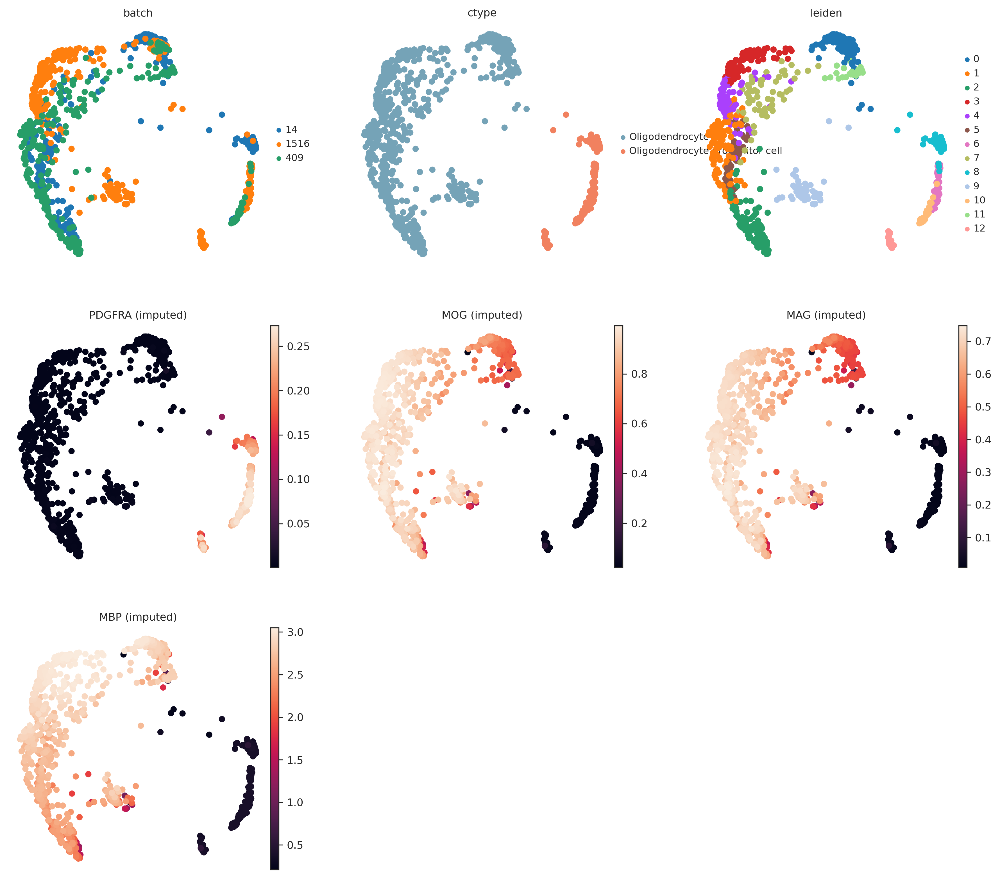

In [73]:
if True:
    # redo phate
#     adata = do_phateumap(adata, bbknn=False)
    adata = do_phateumap(adata)
    goi = ['PDGFRA', 'MOG', 'MAG', 'MBP']
    sc.external.pl.phate(adata, ncols=3, 
                         color=['batch', 'ctype', 'leiden']+['{} (imputed)'.format(i) for i in goi])

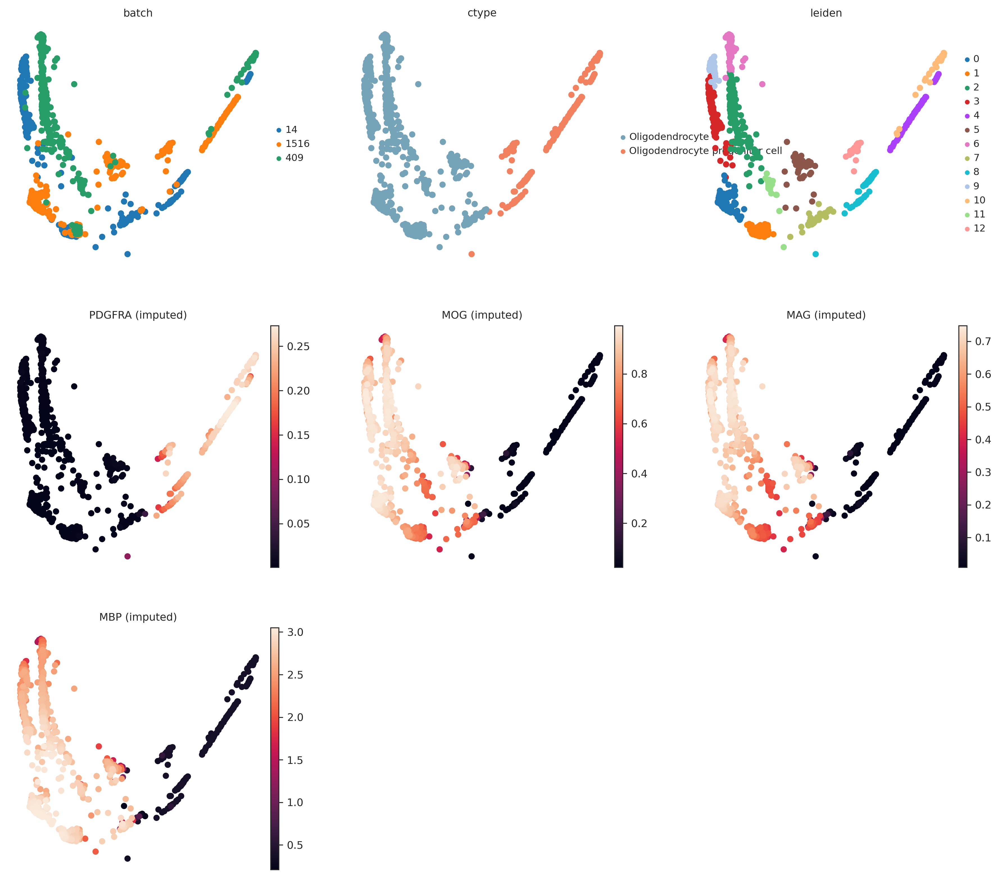

In [63]:
goi = ['PDGFRA', 'MOG', 'MAG', 'MBP']
sc.external.pl.phate(adata, ncols=3, 
                     color=['batch', 'ctype', 'leiden']+['{} (imputed)'.format(i) for i in goi])

In [18]:
scv.pp.moments(adata, n_pcs=50, n_neighbors=30)


Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [19]:
scv.tl.recover_dynamics(adata, n_jobs=-1)
scv.tl.velocity(adata, mode='stochastic')
scv.tl.velocity_graph(adata)


recovering dynamics (using 1/20 cores)



    finished (0:06:18) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:03) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:06) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


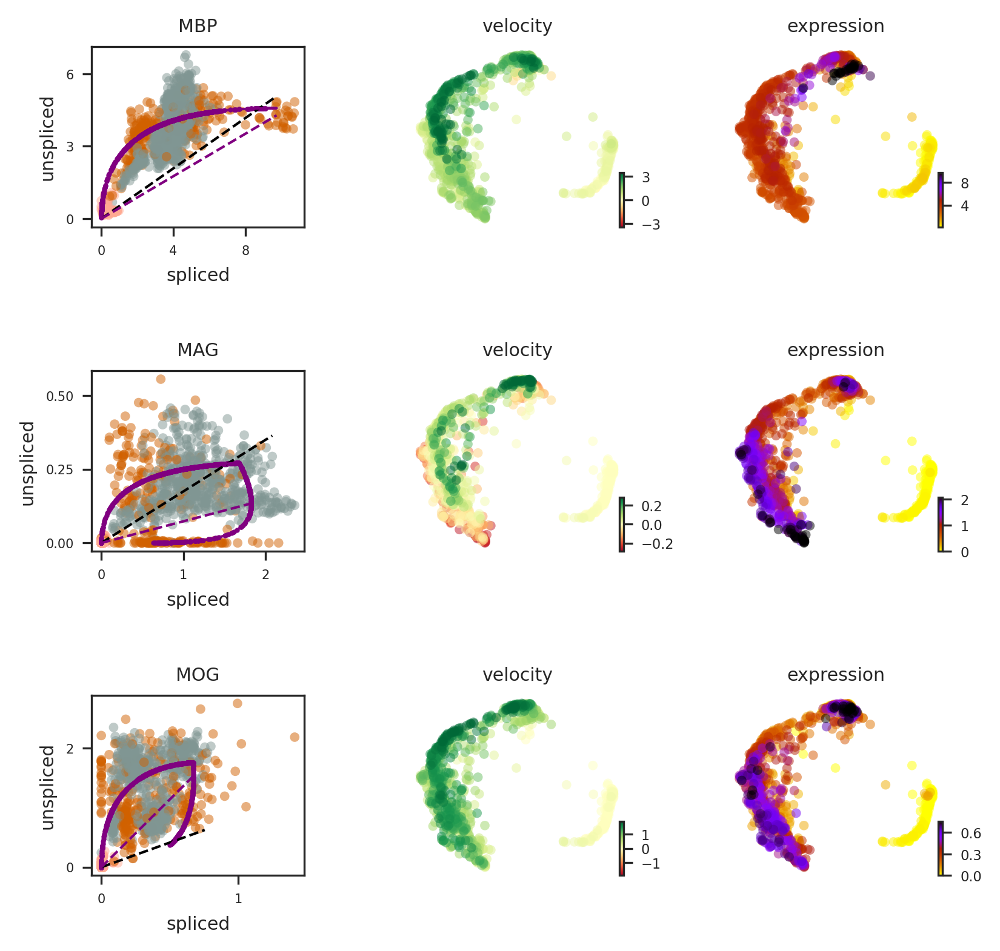

In [20]:
scv.pl.velocity(adata, var_names=['MBP','MAG','MOG'], basis = 'phate')


In [46]:
# root/end cell
root_cellid = adata.obs.loc[adata.obs['ctype']=='Oligodendrocyte progenitor cell', 'PDGFRA (imputed)'].sort_values(ascending=False).index.to_list()[0]
end_cellid = adata.obs.loc[adata.obs['ctype']=='Oligodendrocyte progenitor cell', 'MAG (imputed)'].sort_values(ascending=False).index.to_list()[0]

adata.obs['root'] = False
adata.obs.loc[root_cellid, 'root'] = True
adata.obs['end'] = False
adata.obs.loc[end_cellid, 'end'] = True
adata.uns['root']=np.where(adata.obs['root'])[0][0]
adata.uns['end']=np.where(adata.obs['end'])[0][0]

scv.tl.recover_latent_time(adata,root_key='root', end_key='end')
scv.pl.velocity_embedding_stream(adata, basis='phate', ncols=3,
                                 color=['ctype', 'leiden','latent_time']+['{} (imputed)'.format(i) for i in goi],
                                 figsize=(15, 12),
                                 save='oldhum.pdf')

computing latent time using root cell 671, end as prior
    finished (0:00:01) --> added 
    'latent_time', shared time (adata.obs)
saving figure to file /home/ngr4/project/scnd/results/scvelo_oldhum.pdf


329
computing latent time using root cell 329 as prior
    finished (0:00:01) --> added 
    'latent_time', shared time (adata.obs)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_phate', embedded velocity vectors (adata.obsm)


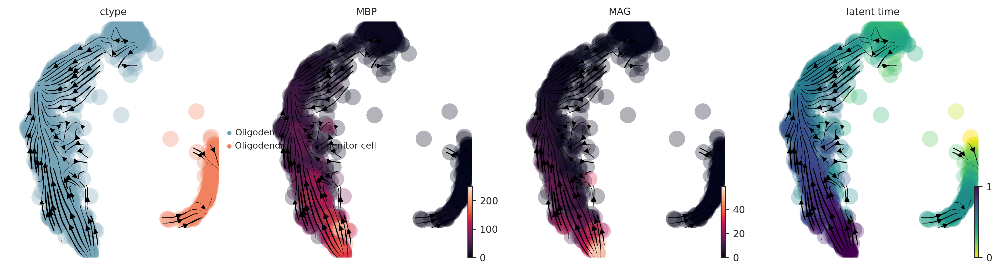

In [21]:
# # compute pseudot (old way)
# idx = np.where(adata.obs['ctype']=='Oligodendrocyte progenitor cell')[0]
# idx = idx[np.argmax(adata[:,['PDGFRA']].X[idx])]
# adata.obs['root']=False
# adata.obs['root'][idx]=True
# print(np.where(adata.obs['root'])[0][0])
# adata.uns['root']=np.where(adata.obs['root'])[0][0]
# scv.tl.recover_latent_time(adata,root_key='root')
# scv.pl.velocity_embedding_stream(adata, basis='phate', color=['ctype','MBP','MAG', 'latent_time'], legend_loc='right_margin')

In [68]:
scv.pl.velocity_embedding_stream(adata, basis='phate', ncols=3,
                                 color=['ctype', 'leiden','latent_time']+['{} (imputed)'.format(i) for i in goi],
                                 figsize=(15, 12),
                                 save='oldhum.pdf')

saving figure to file /home/ngr4/project/scnd/results/scvelo_oldhum.pdf


In [74]:
# temporary save adata
adata.write('/home/ngr4/scratch60/scnd/data/oldhum_scvpseudot.h5ad')
adata.obs.to_csv(os.path.join(pfp, 'md_oldhum_scvpseudot.csv'))

## heatmap

In [93]:
interactors = pd.read_csv(os.path.join(pfp,'hum_atxn1ints_210401.csv'), header=None)
interactors = interactors[0].to_list()
interactors_in_adata = [i for i in interactors if i in adata.var_names.to_list()]

# out?
if True:
    dt = pd.DataFrame({'interactors_from_Leon':interactors})
    dt['interactors_in_adata'] = pd.Series(interactors_in_adata)
    dt.to_csv(os.path.join(pfp, 'hum_atxn1ints_used.csv'))

In [182]:
# impute
ntimebins = 100
Xprime = do_magic(adata, goi=interactors_in_adata)

if True:
# select genes with non-zero STD
    interactors = pd.Series(interactors_in_adata)[(Xprime.loc[:, interactors_in_adata].std(axis=0)!=0).to_list()].to_list()
    Xprime = Xprime.loc[:, interactors]
else:
    interactors = interactors_in_adata
Xprime = Xprime.merge(adata.obs.loc[:, 'latent_time'], left_index=True, right_index=True) 
_, _, time_groupings = binned_statistic(Xprime['latent_time'], Xprime['latent_time'], bins=ntimebins)
Xprime['pseudot_{}bins'.format(ntimebins)] = time_groupings

Running MAGIC on 1055 cells and 247 genes.
Using precomputed graph and diffusion operator...
Calculating imputation...
Calculated imputation in 0.18 seconds.


In [183]:
# try zscore across cell
Xprime_zscored = Xprime
Xprime_zscored.loc[:, interactors] =  zscore(Xprime_zscored.loc[:, interactors], axis=0)

In [184]:
dt = Xprime_zscored.groupby('pseudot_{}bins'.format(ntimebins)).mean()
dt = dt.loc[:, interactors]
dt = dt.T

In [185]:
cm = plt.get_cmap('viridis')
timecolors = [cm(1.*i/ntimebins) for i in range(ntimebins)]

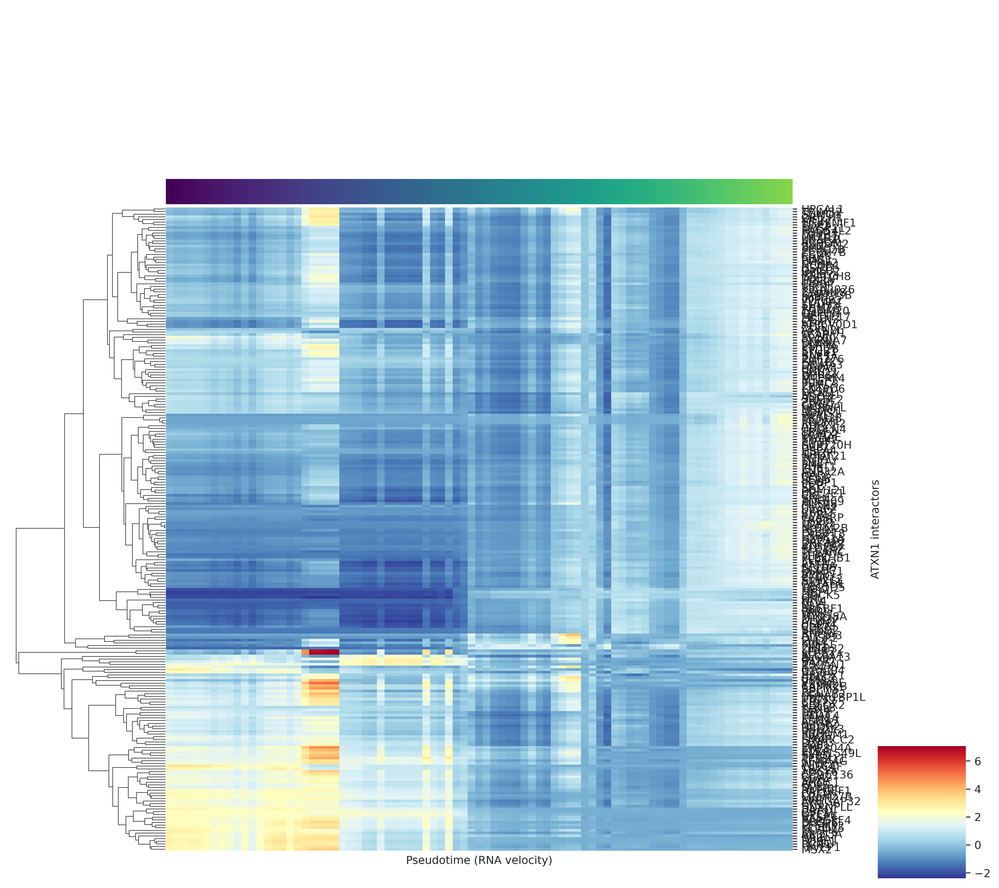

In [188]:
# plot
vminmax = None
p_ = sns.clustermap(
        dt,
        pivot_kws=None,
        method='average',
        metric='euclidean',
        z_score=None,
        standard_scale=None,
        row_cluster=True,
        col_cluster=False,
        row_linkage=None,
#         figsize=(4, 14), 
        col_linkage=None,
        row_colors=None,
        col_colors=timecolors,
        mask=None,
        dendrogram_ratio=0.2,
        colors_ratio=0.03,
        cbar_pos=(1, 0, 0.1, 0.15),
        tree_kws=None,
        cmap='RdYlBu_r',
        yticklabels=True,
        xticklabels=False,
#         vmin=-1*vminmax, vmax=+1*vminmax,
    )
p_.ax_heatmap.set_xlabel('Pseudotime (RNA velocity)')
p_.ax_heatmap.set_ylabel('ATXN1 interactors')

p_.savefig(os.path.join(pfp, 'clustermap_scvelopseudotVhumatxn1ints_vminmax{}.pdf'.format(vminmax)))

In [208]:
# impute
ntimebins = 100
Xprime = do_magic(adata, goi=interactors_in_adata)

if False:
# select genes with non-zero STD
    interactors = pd.Series(interactors_in_adata)[(Xprime.loc[:, interactors_in_adata].std(axis=0)!=0).to_list()].to_list()
    Xprime = Xprime.loc[:, interactors]
else:
    interactors = interactors_in_adata
Xprime = Xprime.merge(adata.obs.loc[:, 'latent_time'], left_index=True, right_index=True) 
_, _, time_groupings = binned_statistic(Xprime['latent_time'], Xprime['latent_time'], bins=ntimebins)
Xprime['pseudot_{}bins'.format(ntimebins)] = time_groupings

Running MAGIC on 1055 cells and 247 genes.
Using precomputed graph and diffusion operator...
Calculating imputation...
Calculated imputation in 0.17 seconds.


In [209]:
dt = Xprime.groupby('pseudot_{}bins'.format(ntimebins)).mean()
dt = dt.loc[:, interactors]
dt = dt.T

In [210]:
cm = plt.get_cmap('viridis')
timecolors = [cm(1.*i/ntimebins) for i in range(ntimebins)]

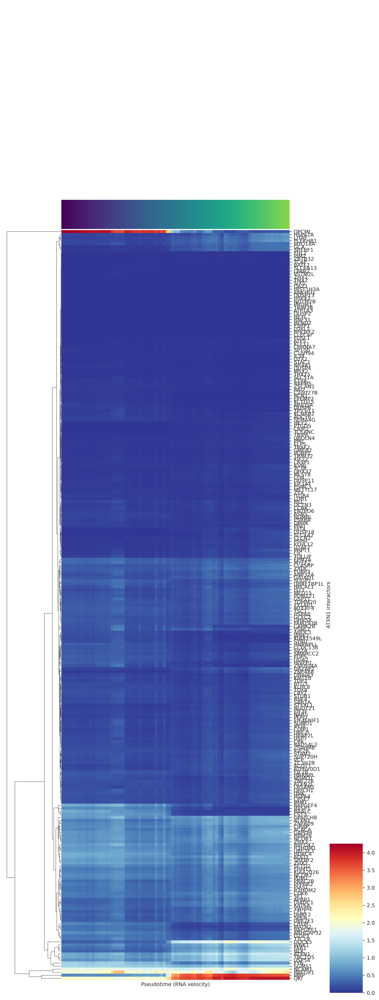

In [211]:
# plot
vminmax = None
p_ = sns.clustermap(
        dt,
        pivot_kws=None,
        method='average',
        metric='euclidean',
        z_score=None,
        standard_scale=None,
        row_cluster=True,
        col_cluster=False,
        row_linkage=None,
        figsize=(8, 24), 
        col_linkage=None,
        row_colors=None,
        col_colors=timecolors,
        mask=None,
        dendrogram_ratio=0.2,
        colors_ratio=0.03,
        cbar_pos=(1, 0, 0.1, 0.15),
        tree_kws=None,
        cmap='RdYlBu_r',
        yticklabels=True,
        xticklabels=False,
#         vmin=-1*vminmax, vmax=+1*vminmax,
    )
p_.ax_heatmap.set_xlabel('Pseudotime (RNA velocity)')
p_.ax_heatmap.set_ylabel('ATXN1 interactors')

p_.savefig(os.path.join(pfp, 'clustermap_scvelopseudotVhumatxn1ints_imp_vminmax{}.pdf'.format(vminmax)))

In [252]:
# impute
ntimebins = 20
Xprime = do_magic(adata, goi=interactors_in_adata)

if False:
# select genes with non-zero STD
    interactors = pd.Series(interactors_in_adata)[(Xprime.loc[:, interactors_in_adata].std(axis=0)!=0).to_list()].to_list()
    Xprime = Xprime.loc[:, interactors]
else:
    interactors = interactors_in_adata
Xprime = Xprime.merge(adata.obs.loc[:, 'latent_time'], left_index=True, right_index=True) 


Running MAGIC on 1055 cells and 247 genes.
Using precomputed graph and diffusion operator...
Calculating imputation...
Calculated imputation in 0.17 seconds.


In [248]:
Xprime.head()

,ACACA,ACOT7,ADCY6,ADD3,AHDC1,ANKHD1,ANP32A,APBB1,ARHGAP32,ARID5A,...,ZNF276,ZNF488,ZNF609,ZNF804A,ZSCAN1,ZSWIM8,ZXDC,ZYX,latent_time,pseudot_20bins
AAACGCTAGACAACAT,0.412462,0.079760,0.061816,0.646667,0.135836,0.0,0.143687,0.253899,0.447063,0.041316,...,0.171167,0.028428,0.460086,0.134365,0.050273,0.128142,0.226056,0.041645,0.358884,8
AAAGTCCGTGTTTCTT,0.848995,0.320063,0.058668,0.747785,0.117894,0.0,0.500840,0.706709,0.434324,0.031764,...,0.237600,0.344269,0.857858,0.055052,0.015920,0.208683,0.504635,0.087433,0.917102,19
AACAAAGTCTCAACGA-1,0.838527,0.292639,0.049725,0.813348,0.122193,0.0,0.461966,0.669129,0.414841,0.028747,...,0.229095,0.285060,0.878871,0.052817,0.017586,0.205535,0.489789,0.074919,0.983106,20
AACAGGGCACTAAACC,0.743808,0.255818,0.042863,0.860307,0.129188,0.0,0.385159,0.597370,0.314807,0.020250,...,0.195770,0.182769,0.840306,0.146273,0.015384,0.199164,0.427910,0.059857,0.626997,13
AACCACAGTGTGAATA,0.406227,0.145935,0.006854,0.512817,0.022099,0.0,0.155015,0.273344,0.194493,0.007286,...,0.060005,0.063312,0.572148,0.046051,0.012229,0.082824,0.261897,0.018839,0.831711,17


In [260]:
if True: 
    # range scale
    Xprime.loc[:, interactors] = (Xprime.loc[:, interactors] - Xprime.loc[:, interactors].min(axis=0)) / (Xprime.loc[:, interactors].max(axis=0) - Xprime.loc[:, interactors].min(axis=0))

In [264]:
dt = Xprime.melt(id_vars=['latent_time'], value_name='expression', var_name='gene')
dt = dt.loc[dt['gene'].isin([
    'ATXN1', 'ATXN1L', 'CIC', 'PDGFRA', 'MOG', 'TCF7L2', 
    'OPCML', 'MBP', 'QKI', 'RBFOX1', 'DOCK5', 'CNP', 
    'PLP1', 'MYRF', 'ETV4', 'TBX15', 'ZNF804A', 'DUSP2', 
    'RBFOX2', 'HDAC4']), :]

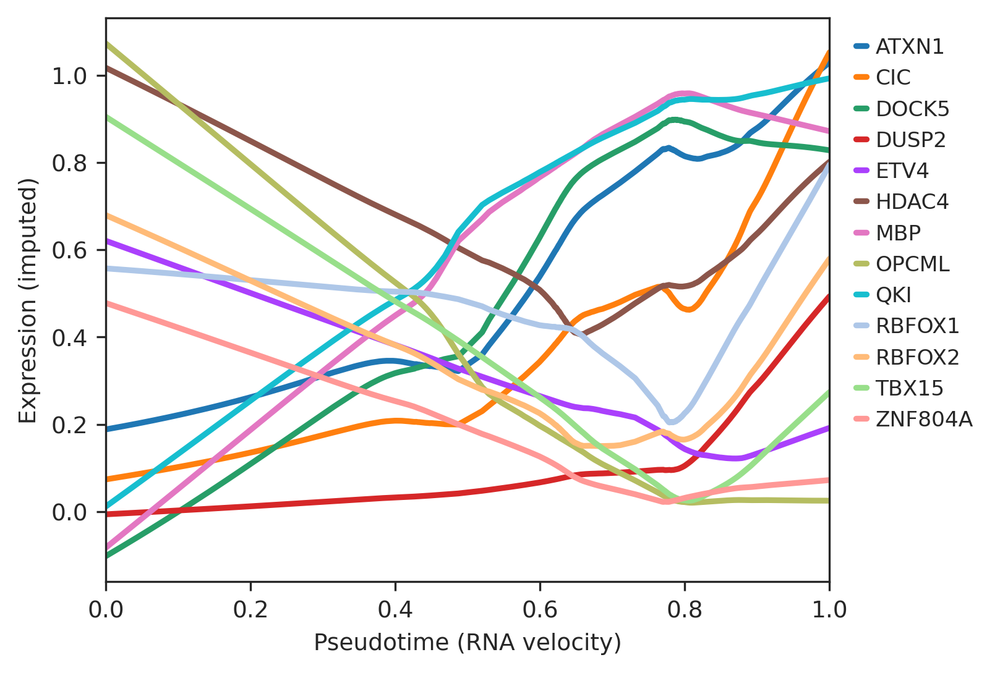

In [281]:
fig, ax = plt.subplots(1, 1, figsize=(5,4))
for i, g in enumerate(dt['gene'].unique()):
    sns.regplot(
        x='latent_time',
        y='expression',
    #     hue='gene',
        data=dt.loc[dt['gene']==g],
        lowess=True,
        ax=ax,
        scatter=False,
        color=sns.color_palette()[i],
#         line_kws={'color':sns.color_palette()[i]},
        label=g,
        ci=95,
    )
    ax.set_ylabel('Expression (imputed)')
    ax.set_xlabel('Pseudotime (RNA velocity)')
ax.legend(bbox_to_anchor=(1.01, 1))
fig.savefig(os.path.join(pfp, 'line_impexpressionVbinnedpseudot.pdf'))

In [282]:
from skmisc.loess import loess


ModuleNotFoundError: No module named 'skmisc'

# old

In [13]:
wt = phateumap(wt,plot=None,recalculate=True,save=None,title=None,bbknn=True,cluster='batch',cmap=None)
sca = phateumap(sca,plot=None,recalculate=True,save=None,title=None,bbknn=True,cluster='batch',cmap=None)

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 100
    finished (0:00:01)
computing batch balanced neighbors
	finished (0:00:02)
computing UMAP
    finished (0:00:04)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00)
Calculating PHATE...
  Running PHATE on precomputed affinity matrix with 1055 cells.
  Calculating graph and diffusion operator...
  Calculating optimal t...
  Calculated optimal t in 0.36 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.10 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 9.36 seconds.
Calculated PHATE in 9.87 seconds.
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproduc

In [14]:
# X.obsm['X_phate']=x.obsm['X_phate']
# X.obsm['X_umap']=x.obsm['X_umap']

In [15]:
# X.obs['genotype']=['SCA1' if 'SCA' in i else 'CTRL' for i in X.obs['Sample']]

In [16]:
pal18=['#ee5264','#565656','#75a3b7','#ffe79e','#fac18a','#f1815f','#ac5861','#62354f','#2d284b','#f4b9b9','#c4bbaf',
               '#f9ebae','#aecef9','#aeb7f9','#f9aeae','#9c9583','#88bb92','#bde4a7','#d6e5e3']


In [17]:
# for k,v in X.uns.items():
#     if 'color' in k:
#         X.uns[k]=np.array(pal18,dtype=object)

computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on modularity on velocity field (adata.obs)
ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns)


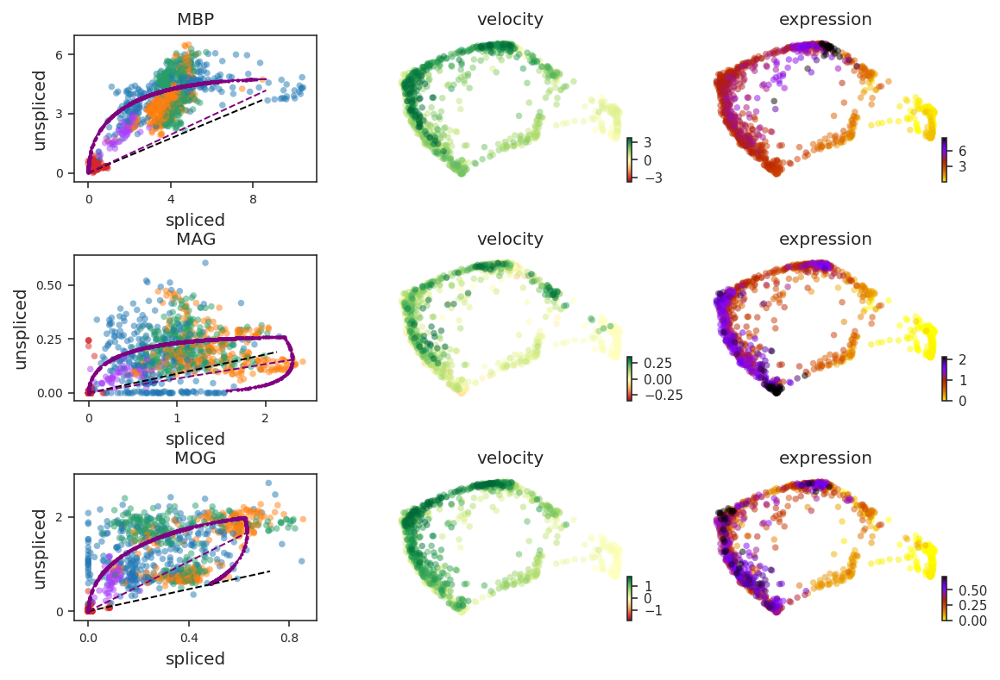

In [18]:
scv.tl.rank_velocity_genes(wt, match_with='ctype')
scv.pl.velocity(wt, var_names=['MBP','MAG','MOG'], basis = 'phate')


computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on modularity on velocity field (adata.obs)
ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns)


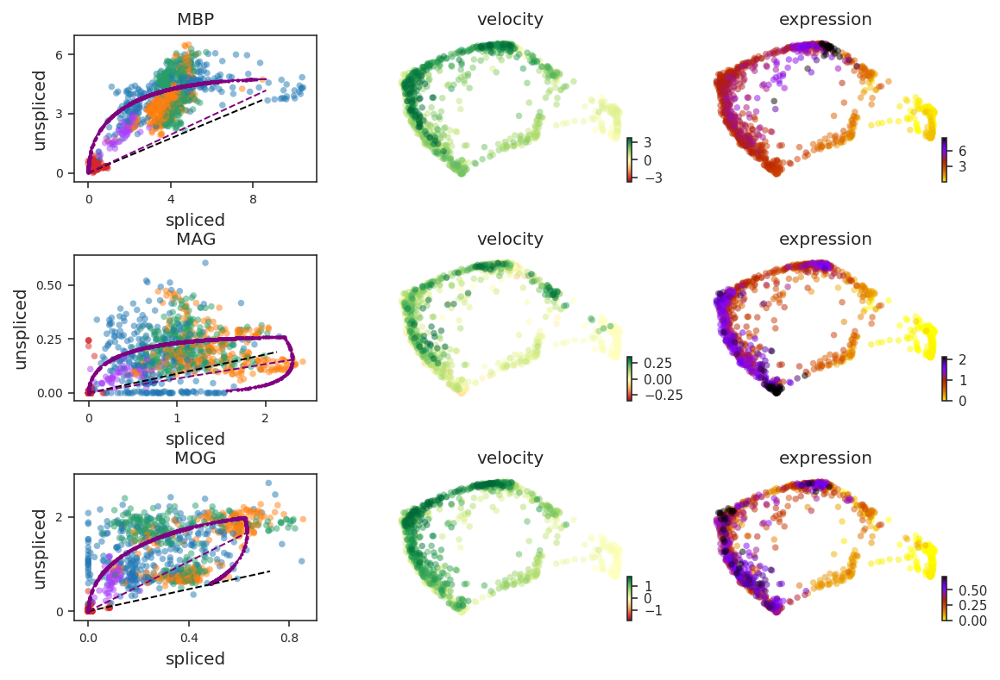

In [19]:
scv.tl.rank_velocity_genes(wt, match_with='ctype')
scv.pl.velocity(wt, var_names=['MBP','MAG','MOG'], basis = 'phate')


In [20]:
idx = np.where(wt.obs['ctype']=='Oligodendrocyte progenitor cell')[0]
idx = idx[np.argmax(wt[:,['PDGFRA']].X[idx])]


329
computing latent time
computing terminal states
    identified 1 region of root cells and 2 regions of end points 
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_phate', embedded velocity vectors (adata.obsm)


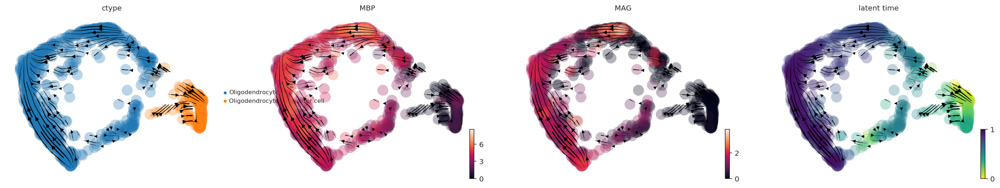

In [21]:
# with root
if False: 
    # random
    idx = np.where(wt.obs['ctype']=='Oligodendrocyte progenitor cell')[0]
    wt.obs['root']=False
    wt.obs['root'][np.random.choice(idx)]=True
    wt.uns['root']=np.where(wt.obs['root'])[0][0]
    scv.tl.recover_latent_time(wt,root_key='root')
    scv.pl.velocity_embedding_stream(wt, basis='phate', color=['ctype','MBP','MAG', 'latent_time'], legend_loc='right_margin')
elif True:
    # with max(sum(PDGFRA normed expression))
    idx = np.where(wt.obs['ctype']=='Oligodendrocyte progenitor cell')[0]
    idx = idx[np.argmax(wt[:,['PDGFRA']].X[idx])]
    wt.obs['root']=False
    wt.obs['root'][idx]=True
    print(np.where(wt.obs['root'])[0][0])
    wt.uns['root']=np.where(wt.obs['root'])[0][0]
    scv.tl.recover_latent_time(wt,root_key='root')
    scv.pl.velocity_embedding_stream(wt, basis='phate', color=['ctype','MBP','MAG', 'latent_time'], legend_loc='right_margin')
else:
    # with max(sum(PDGFRA, OLIG1, OLIG2 normed expression))
    idx = np.where(wt.obs['ctype']=='Oligodendrocyte progenitor cell')[0]
    idx = idx[np.argmax(wt[:,['PDGFRA','OLIG1','OLIG2']].X.todense()[idx,:].sum(axis=1))]
    wt.obs['root']=False
    wt.obs['root'][idx]=True
    print(np.where(wt.obs['root'])[0][0])
    wt.uns['root']=np.where(wt.obs['root'])[0][0]
    scv.tl.recover_latent_time(wt,root_key='root')
    scv.pl.velocity_embedding_stream(wt, basis='phate', color=['ctype','MBP','MAG', 'latent_time'], legend_loc='right_margin')


536
computing latent time
computing terminal states
    identified 0 region of root cells and 2 regions of end points 
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_phate', embedded velocity vectors (adata.obsm)


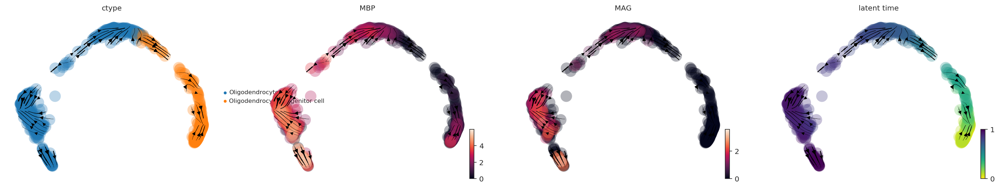

In [22]:
# with root
if False: 
    # random
    idx = np.where(sca.obs['ctype']=='Oligodendrocyte progenitor cell')[0]
    sca.obs['root']=False
    sca.obs['root'][np.random.choice(idx)]=True
    sca.uns['root']=np.where(sca.obs['root'])[0][0]
    scv.tl.recover_latent_time(sca,root_key='root')
    scv.pl.velocity_embedding_stream(sca, basis='phate', color=['ctype','MBP','MAG', 'latent_time'], legend_loc='right_margin')
elif True:
    # with max(sum(PDGFRA normed expression))
    idx = np.where(sca.obs['ctype']=='Oligodendrocyte progenitor cell')[0]
    idx = idx[np.argmax(sca[:,['PDGFRA']].X[idx])]
    sca.obs['root']=False
    sca.obs['root'][idx]=True
    print(np.where(sca.obs['root'])[0][0])
    sca.uns['root']=np.where(sca.obs['root'])[0][0]
    scv.tl.recover_latent_time(sca,root_key='root')
    scv.pl.velocity_embedding_stream(sca, basis='phate', color=['ctype','MBP','MAG', 'latent_time'], legend_loc='right_margin')
else:
    # with max(sum(PDGFRA, OLIG1, OLIG2 normed expression))
    idx = np.where(sca.obs['ctype']=='Oligodendrocyte progenitor cell')[0]
    idx = idx[np.argmax(sca[:,['PDGFRA','OLIG1','OLIG2']].X.todense()[idx,:].sum(axis=1))]
    sca.obs['root']=False
    sca.obs['root'][idx]=True
    print(np.where(sca.obs['root'])[0][0])
    sca.uns['root']=np.where(sca.obs['root'])[0][0]
    scv.tl.recover_latent_time(sca,root_key='root')
    scv.pl.velocity_embedding_stream(sca, basis='phate', color=['ctype','MBP','MAG', 'latent_time'], legend_loc='right_margin')


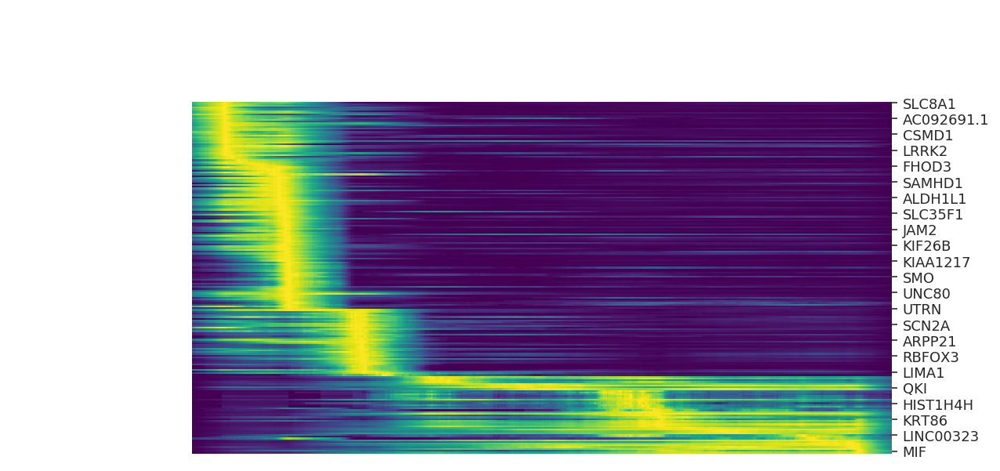

In [23]:
top_genes = wt.var_names[wt.var.fit_likelihood.argsort()[::-1]][:200]
scv.pl.heatmap(wt, var_names=top_genes, tkey='latent_time', n_convolve=100)


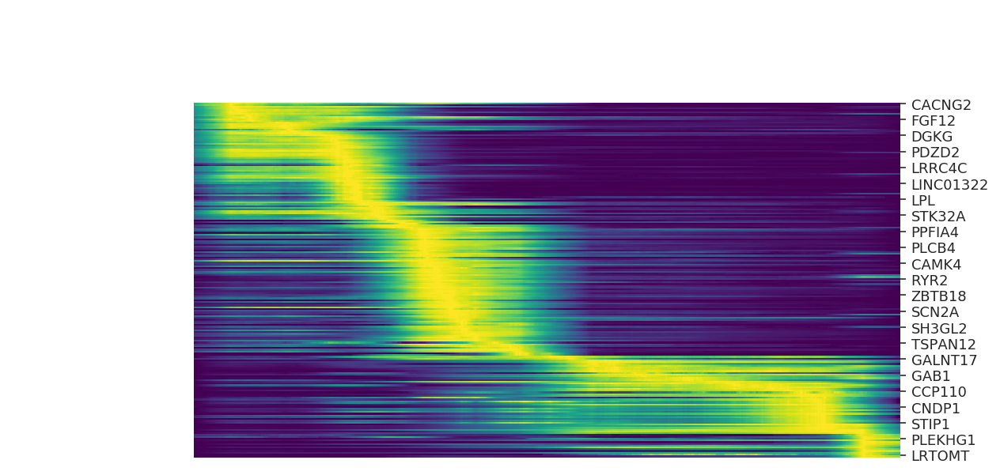

In [24]:
top_genes = sca.var_names[sca.var.fit_likelihood.argsort()[::-1]][:200]
scv.pl.heatmap(sca, var_names=top_genes, tkey='latent_time', n_convolve=100)


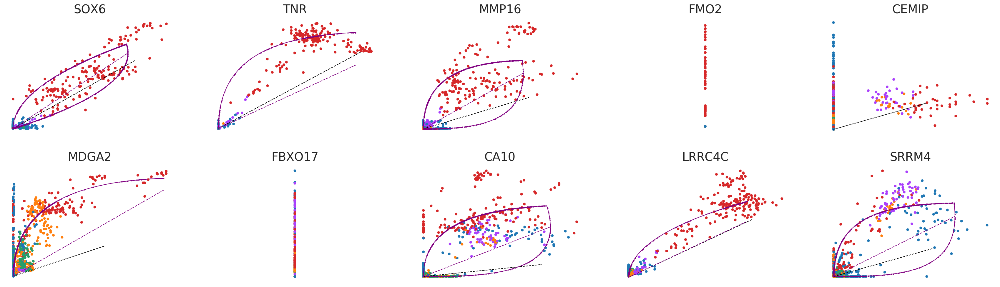

In [25]:
scv.pl.scatter(wt, basis=top_genes[:10], legend_loc='none',
               size=80, frameon=False, ncols=5, fontsize=20)

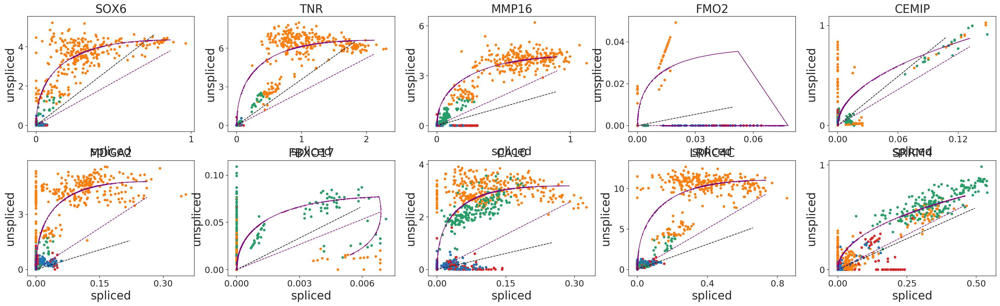

In [26]:
scv.pl.scatter(sca, basis=top_genes[:10], legend_loc='none',
               size=80, frameon=True, ncols=5, fontsize=20)

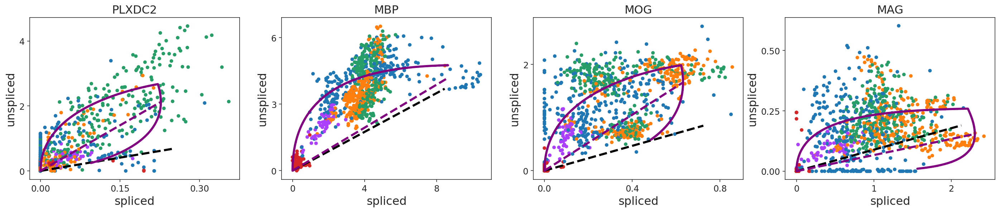

In [27]:
scv.pl.scatter(wt, basis=['PLXDC2', 'MBP', 'MOG', 'MAG'], fontsize=16, size=100, linewidth=3,
               frameon=True, legend_loc='none')

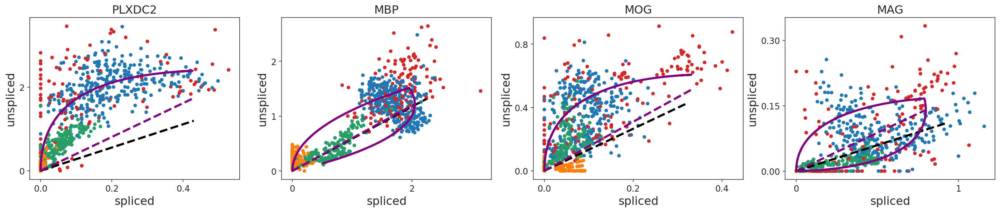

In [28]:
scv.pl.scatter(sca, basis=['PLXDC2', 'MBP', 'MOG', 'MAG'], fontsize=16, size=100, linewidth=3,
               frameon=True, legend_loc='none')

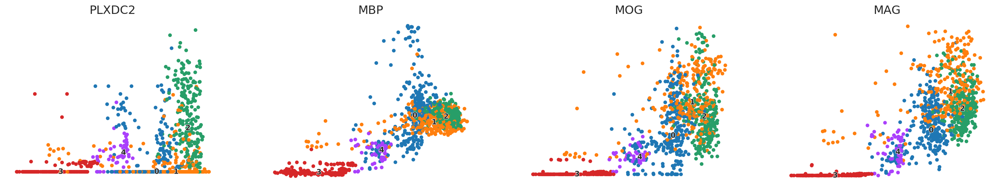

In [29]:
scv.pl.scatter(wt, x='latent_time', y=['PLXDC2', 'MBP', 'MOG', 'MAG'], fontsize=16, size=100,
               n_convolve=None, frameon=False)

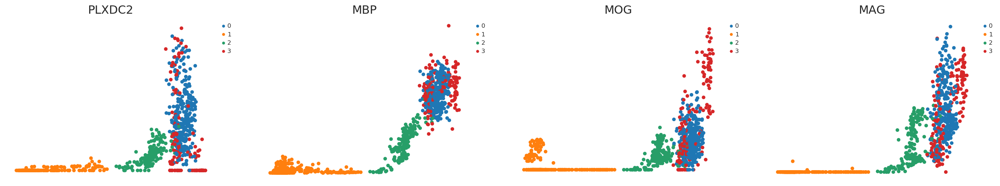

In [30]:
scv.pl.scatter(sca, x='latent_time', y=['PLXDC2', 'MBP', 'MOG', 'MAG'], fontsize=16, size=100,
               n_convolve=None, frameon=False)

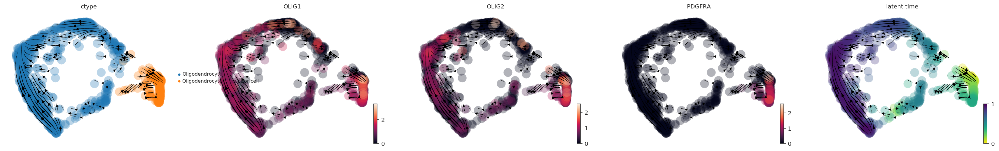

In [78]:
scv.pl.velocity_embedding_stream(wt, basis='phate', color=['ctype','OLIG1','OLIG2', 'PDGFRA', 'latent_time'], 
                                 legend_loc='right_margin',
                                 vmin=0)

saving figure to file /home/ngr4/project/scnd/results/scvelo__wt_stream.png


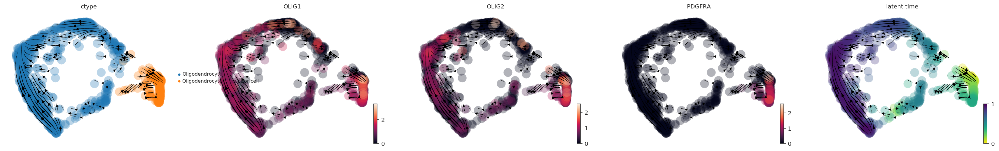

In [74]:
scv.pl.velocity_embedding_stream(wt, basis='phate', color=['ctype','OLIG1','OLIG2', 'PDGFRA', 'latent_time'], 
                                 legend_loc='right_margin',
                                 save='_wt_stream.png')

saving figure to file /home/ngr4/project/scnd/results/scvelo__sca_stream.png


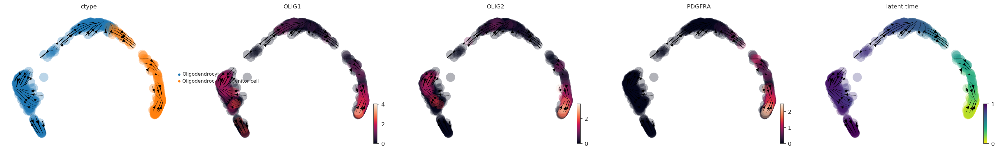

In [76]:
scv.pl.velocity_embedding_stream(sca, basis='phate', color=['ctype','OLIG1','OLIG2', 'PDGFRA', 'latent_time'], legend_loc='right_margin',
                                 save = '_sca_stream.png')

saving figure to file /home/ngr4/project/scnd/results/scvelo__wt_zoomVec.png


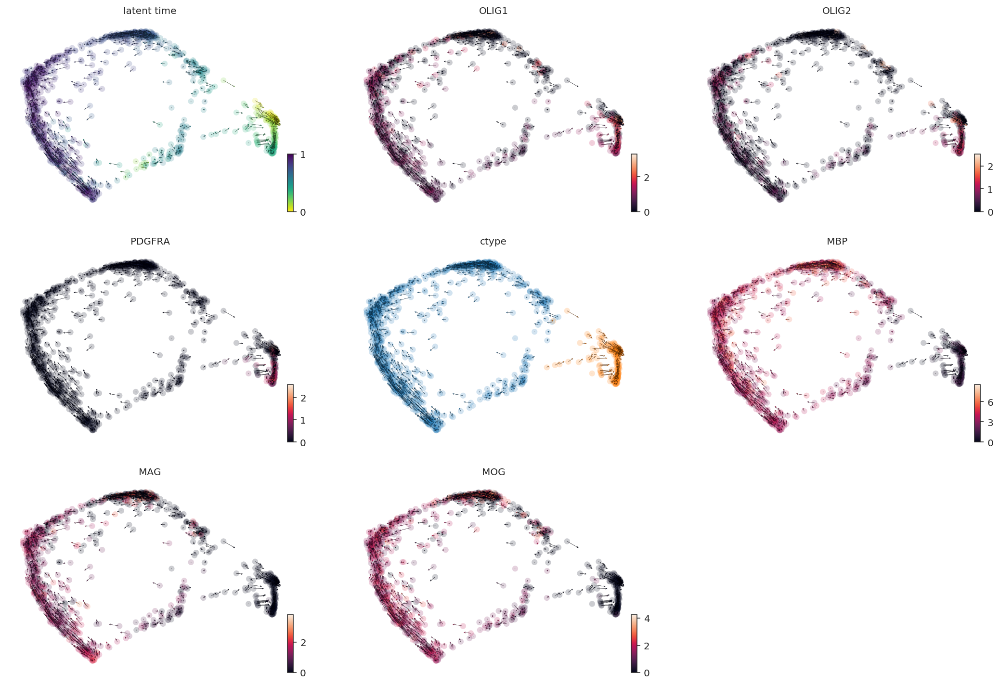

In [75]:
scv.pl.velocity_embedding(wt, basis='phate', color=['latent_time','OLIG1','OLIG2','PDGFRA','ctype',
                                                    'MBP','MAG','MOG'],
                          scale=0.33, size = 150, ncols=3,
                          save='_wt_zoomVec.png')

saving figure to file /home/ngr4/project/scnd/results/scvelo__sca1_zoomVec.pdf


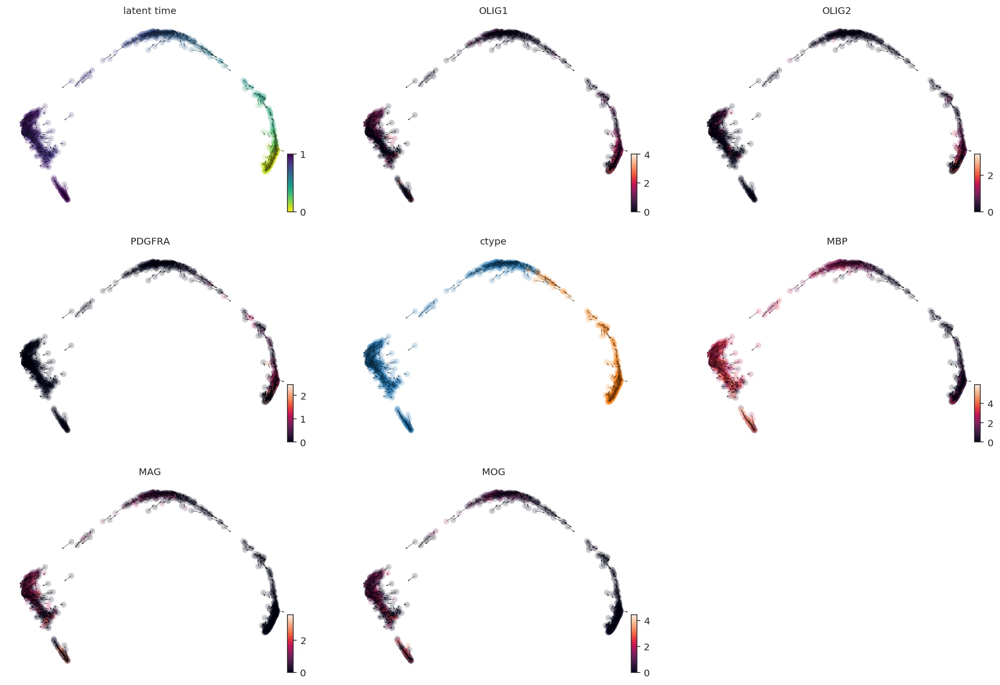

In [68]:
scv.pl.velocity_embedding(sca, basis='phate', color=['latent_time','OLIG1','OLIG2','PDGFRA','ctype',
                                                     'MBP','MAG','MOG'],
                          size = 150, scale = 0.33, ncols=3,
                          save='_sca1_zoomVec.pdf')

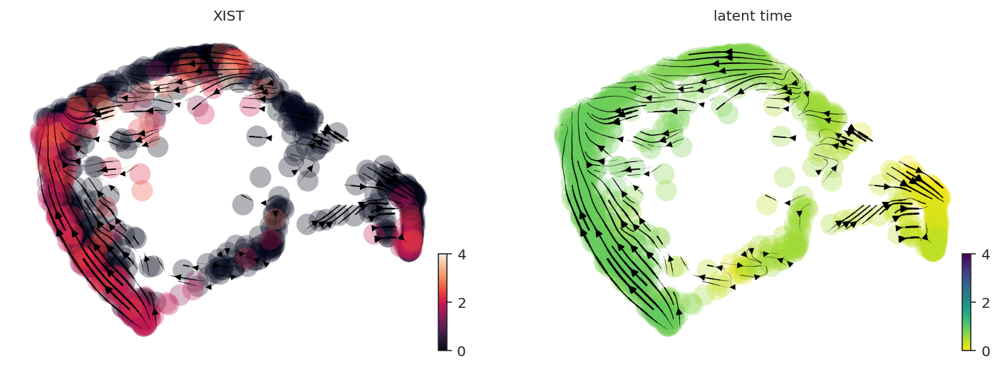

In [80]:
scv.pl.velocity_embedding_stream(wt, basis='phate', color=['XIST', 'latent_time'], 
                                 legend_loc='right_margin', vmin = 0, vmax = 4)

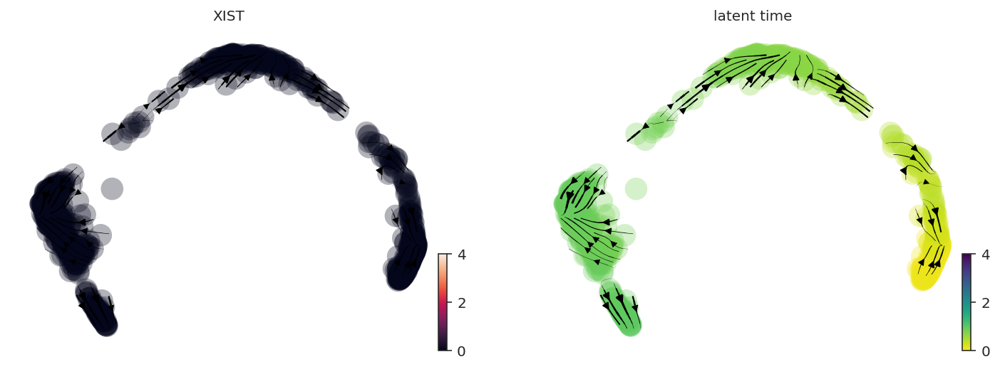

In [79]:
scv.pl.velocity_embedding_stream(sca, basis='phate', color=['XIST', 'latent_time'], 
                                 legend_loc='right_margin', vmin = 0, vmax = 4)

saving figure to file /home/ngr4/project/scnd/results/scvelo__wt_xist.pdf


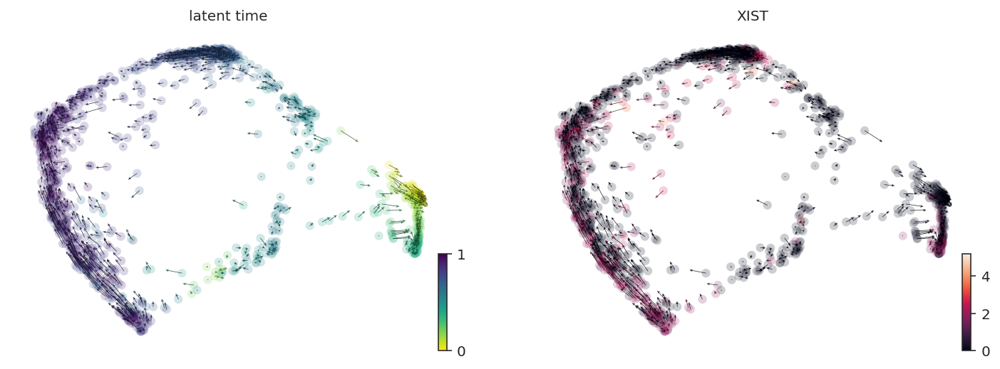

In [63]:
scv.pl.velocity_embedding(wt, basis='phate', color=['latent_time','XIST'],
                          size = 150, scale = 0.33,
                          save='_wt_xist.pdf')

saving figure to file /home/ngr4/project/scnd/results/scvelo__sca1_xist.pdf


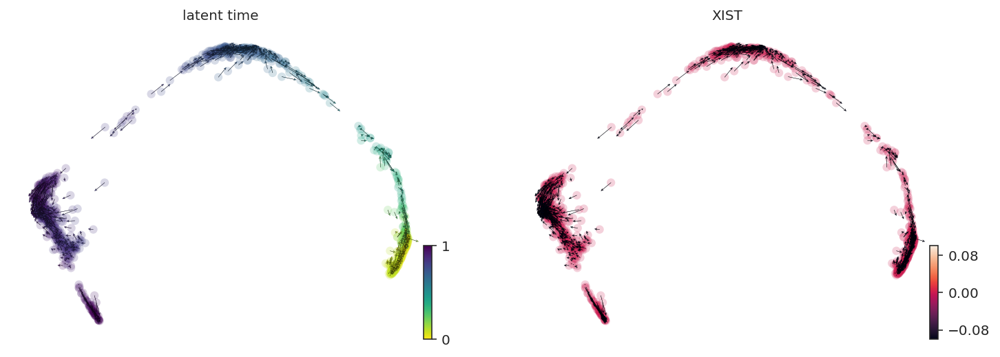

In [62]:
scv.pl.velocity_embedding(sca, basis='phate', color=['latent_time','XIST'],
                          size = 150, scale = 0.33,
                          save='_sca1_xist.pdf')

In [100]:
# assign sex
batch = wt.obs['batch']

sex = []
for i,b in enumerate(batch):
    if b=='1-Jan' or b=='2-Jan' or b=='14' or b=='1516':
        sex.append('M')
    elif b=='409' or b=='3-Jan':
        sex.append('F')
    else:
        raise ValueError('A non-encoded value was encountered: "{}" ({})'.format(b,type(b)))
        
wt.obs['sex']=sex

batch = sca.obs['batch']

sex = []
for i,b in enumerate(batch):
    if b=='1-Jan' or b=='2-Jan' or b=='14' or b=='1516':
        sex.append('M')
    elif b=='409' or b=='3-Jan':
        sex.append('F')
    else:
        raise ValueError('A non-encoded value was encountered: "{}" ({})'.format(b,type(b)))
        
sca.obs['sex']=sex
    
cmap_sex = {'M':'#4d6fa1',
            'F':'#f08381'}   

wt.uns['sex_colors'] = [cmap_sex['F'], cmap_sex['M']]
sca.uns['sex_colors'] = [cmap_sex['F'], cmap_sex['M']]

In [111]:
# tweak ctype colors
wt.uns['ctype_colors'] = ['#75a3b7', '#f1815f']
sca.uns['ctype_colors'] = ['#75a3b7', '#f1815f']

saving figure to file /home/ngr4/project/scnd/results/scvelo__WTctype.png


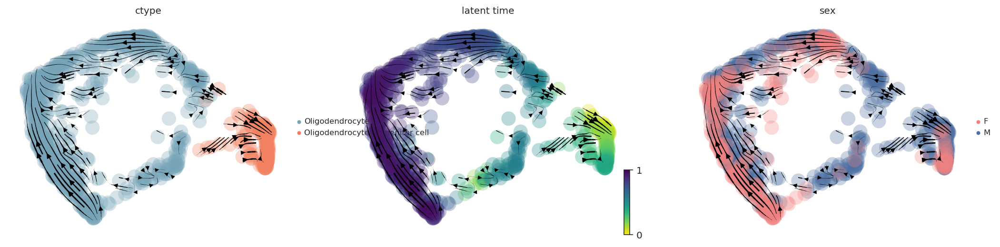

In [112]:
scv.pl.velocity_embedding_stream(wt, basis='phate', color=['ctype', 'latent_time', 'sex'], 
                                 legend_loc='right_margin', 
                                 save = '_WTctype.png')

saving figure to file /home/ngr4/project/scnd/results/scvelo__SCActype.png


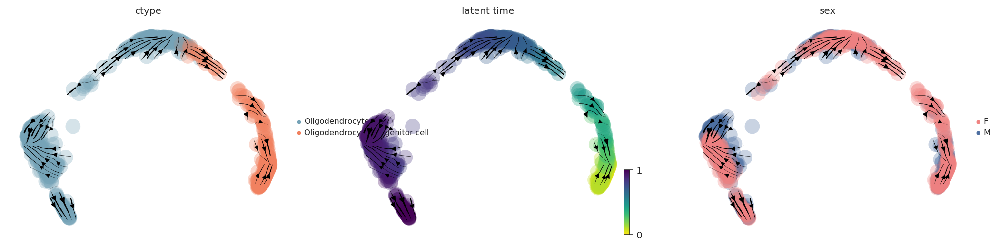

In [113]:
scv.pl.velocity_embedding_stream(sca, basis='phate', color=['ctype', 'latent_time', 'sex'], 
                                 legend_loc='right_margin', 
                                 save = '_SCActype.png')

saving figure to file /home/ngr4/project/scnd/results/scvelo__WTxist_sex.png


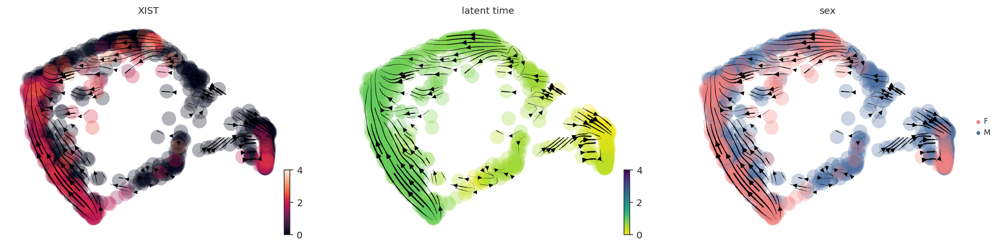

In [103]:
scv.pl.velocity_embedding_stream(wt, basis='phate', color=['XIST', 'latent_time', 'sex'], 
                                 legend_loc='right_margin', vmin = 0, vmax = 4,
                                 save = '_WTxist_sex.png')

saving figure to file /home/ngr4/project/scnd/results/scvelo__SCAxist_sex.png


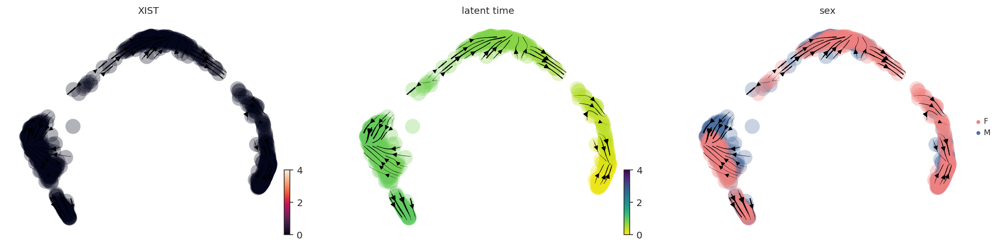

In [104]:
scv.pl.velocity_embedding_stream(sca, basis='phate', color=['XIST', 'latent_time', 'sex'], 
                                 legend_loc='right_margin', vmin = 0, vmax = 4, 
                                 save = '_SCAxist_sex.png')

saving figure to file /home/ngr4/project/scnd/results/scvelo__wt_zoomVec.pdf


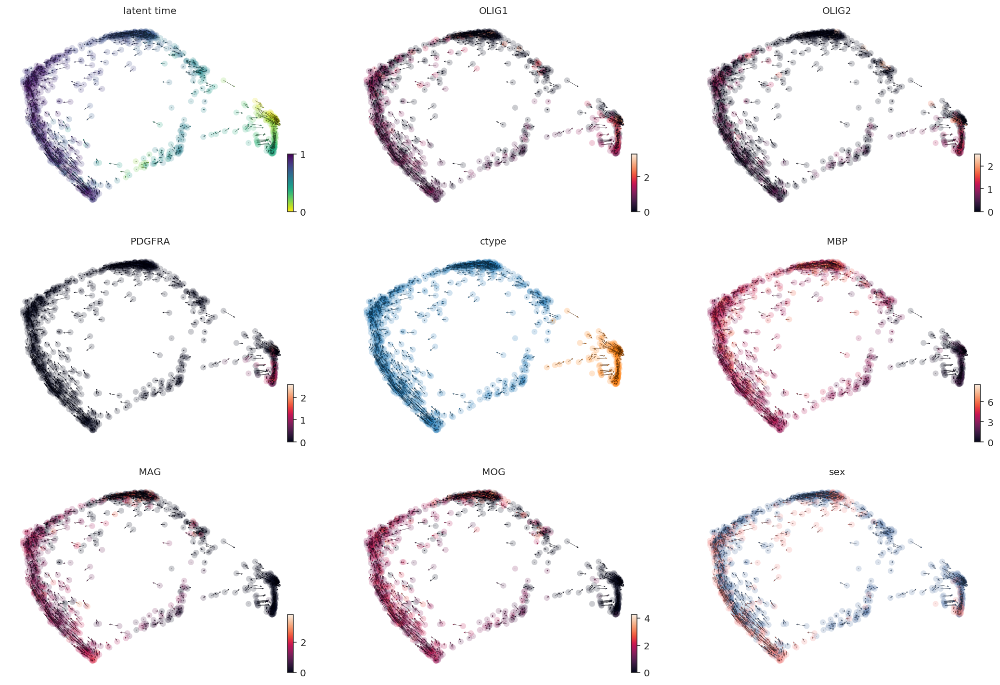

In [108]:
scv.pl.velocity_embedding(wt, basis='phate', color=['latent_time','OLIG1','OLIG2','PDGFRA','ctype',
                                                     'MBP','MAG','MOG', 'sex'],
                          size = 150, scale = 0.33, ncols=3,
                          save='_wt_zoomVec.pdf')

saving figure to file /home/ngr4/project/scnd/results/scvelo__sca1_zoomVec.pdf


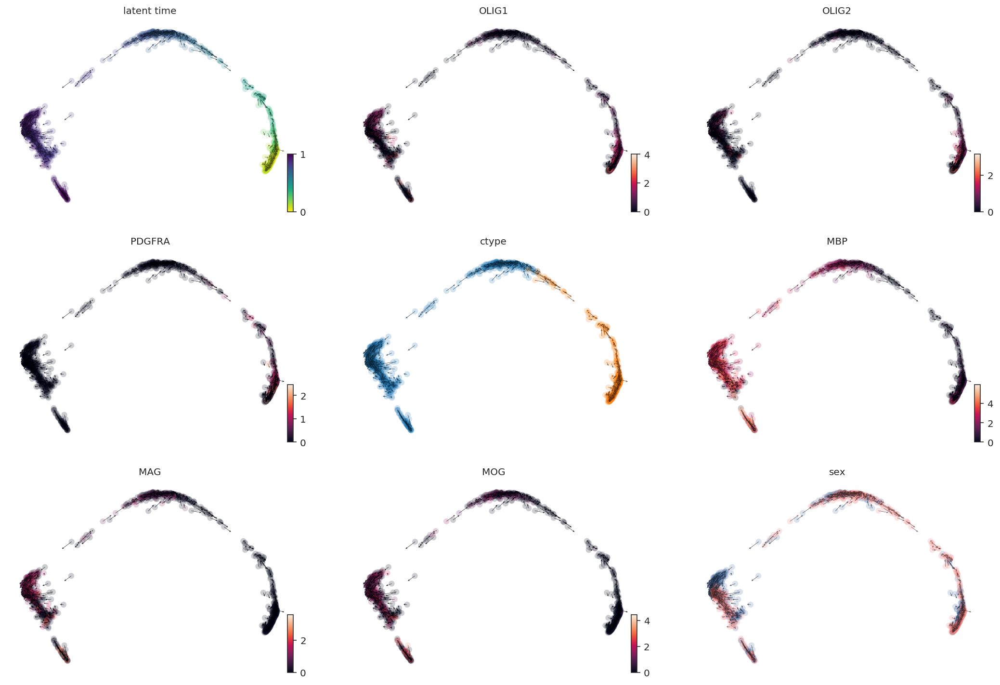

In [107]:
scv.pl.velocity_embedding(sca, basis='phate', color=['latent_time','OLIG1','OLIG2','PDGFRA','ctype',
                                                     'MBP','MAG','MOG','sex'],
                          size = 150, scale = 0.33, ncols=3,
                          save='_sca1_zoomVec.pdf')

saving figure to file /home/ngr4/project/scnd/results/scvelo__WTtime.png


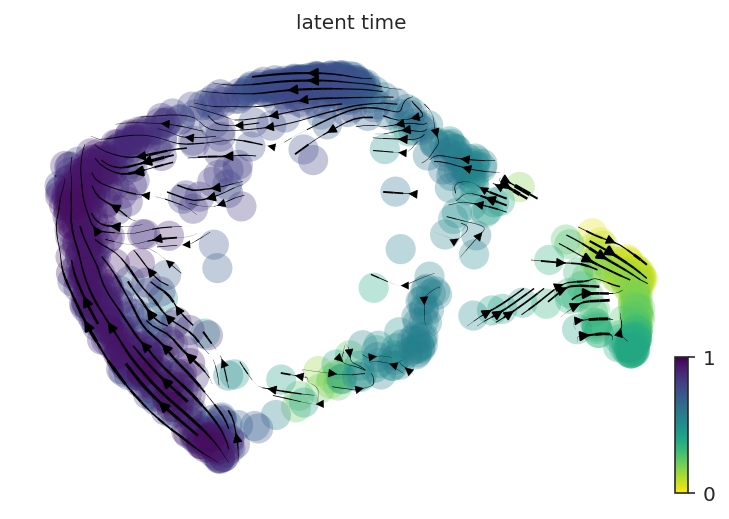

In [114]:
scv.pl.velocity_embedding_stream(wt, basis='phate', color=['latent_time'], 
                                 legend_loc='right_margin', 
                                 save = '_WTtime.png')

saving figure to file /home/ngr4/project/scnd/results/scvelo__SCAtime.png


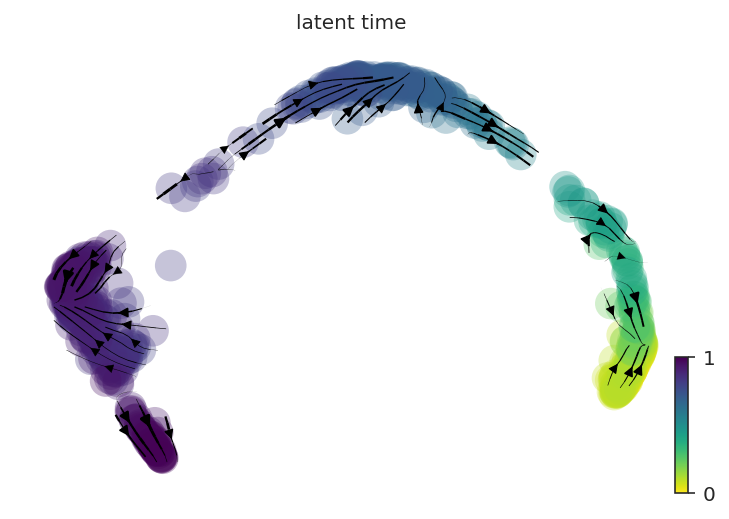

In [115]:
scv.pl.velocity_embedding_stream(sca, basis='phate', color=['latent_time'], 
                                 legend_loc='right_margin', 
                                 save = '_SCAtime.png')

saving figure to file /home/ngr4/project/scnd/results/scvelo__wt1_zoomVectime.pdf


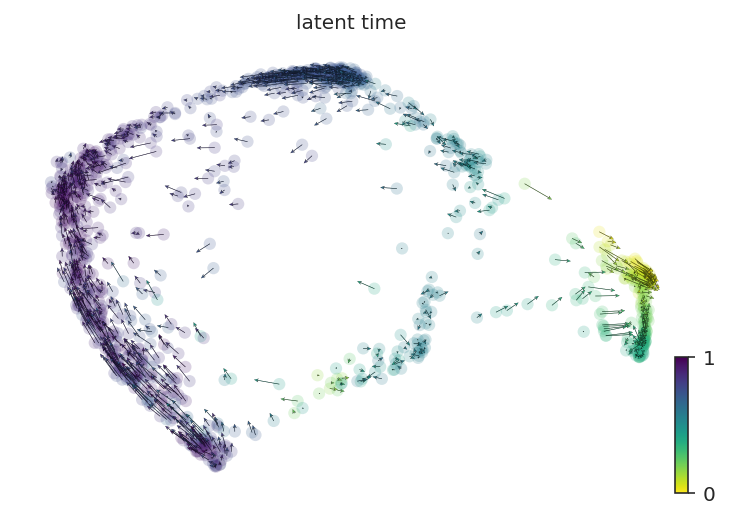

In [117]:
scv.pl.velocity_embedding(wt, basis='phate', color=['latent_time'],
                          size = 150, scale = 0.33, 
                          save='_wt1_zoomVectime.pdf')

saving figure to file /home/ngr4/project/scnd/results/scvelo__sca1_zoomVectime.pdf


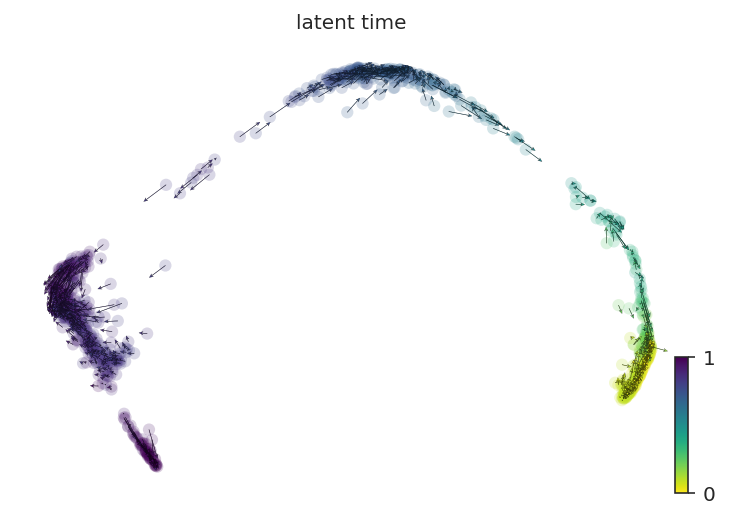

In [116]:
scv.pl.velocity_embedding(sca, basis='phate', color=['latent_time'],
                          size = 150, scale = 0.33, 
                          save='_sca1_zoomVectime.pdf')